Copyright by Arjun Sarkar Research Group Applied Systems Biology - Head: Prof. Dr. Marc Thilo Figge https://www.leibniz-hki.de/en/applied-systems-biology.html HKI-Center for Systems Biology of Infection Leibniz Institute for Natural Product Research and Infection Biology - Hans Knöll Insitute (HKI) Adolf-Reichwein-Straße 23, 07745 Jena, Germany

In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import cv2 as cv
import math
from mlxtend.plotting import plot_confusion_matrix
from sklearn.metrics import confusion_matrix

from sklearn import preprocessing
import datetime

import tensorflow as tf

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import EfficientNetB5, preprocess_input
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping,ModelCheckpoint,ReduceLROnPlateau

from sklearn.model_selection import train_test_split

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"]="2"

strategy = tf.distribute.MirroredStrategy(["GPU:0"])

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [3]:
df = pd.read_csv('Label_Patches_Training.csv')
df.head()

,video_num,filename,patch_name,infection,patient,class_label,image_path
0,1,246,246_0_0.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_0_0.tif
1,1,246,246_0_1.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_0_1.tif
2,1,246,246_1_0.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_1_0.tif
3,1,246,246_1_1.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_1_1.tif
4,1,94,094_0_0.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/094_0_0.tif


In [4]:
test = df[(df['patient']==12)]
test

,video_num,filename,patch_name,infection,patient,class_label,image_path
24960,33,246,246_0_0.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/246_0_0.tif
24961,33,246,246_0_1.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/246_0_1.tif
24962,33,246,246_1_0.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/246_1_0.tif
24963,33,246,246_1_1.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/246_1_1.tif
24964,33,94,094_0_0.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/094_0_0.tif
...,...,...,...,...,...,...,...
28075,35,250,250_1_1.tif,mock,12,2,/asbdata/Arjun/Bloodi/Patches/35/250_1_1.tif
28076,35,227,227_0_0.tif,mock,12,2,/asbdata/Arjun/Bloodi/Patches/35/227_0_0.tif
28077,35,227,227_0_1.tif,mock,12,2,/asbdata/Arjun/Bloodi/Patches/35/227_0_1.tif
28078,35,227,227_1_0.tif,mock,12,2,/asbdata/Arjun/Bloodi/Patches/35/227_1_0.tif


In [5]:
Xtrain = pd.concat([df, test]).drop_duplicates(keep=False)
Xtrain

,video_num,filename,patch_name,infection,patient,class_label,image_path
0,1,246,246_0_0.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_0_0.tif
1,1,246,246_0_1.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_0_1.tif
2,1,246,246_1_0.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_1_0.tif
3,1,246,246_1_1.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/246_1_1.tif
4,1,94,094_0_0.tif,ca,1,0,/asbdata/Arjun/Bloodi/Patches/1/094_0_0.tif
...,...,...,...,...,...,...,...
24955,32,250,250_1_1.tif,mock,11,2,/asbdata/Arjun/Bloodi/Patches/32/250_1_1.tif
24956,32,227,227_0_0.tif,mock,11,2,/asbdata/Arjun/Bloodi/Patches/32/227_0_0.tif
24957,32,227,227_0_1.tif,mock,11,2,/asbdata/Arjun/Bloodi/Patches/32/227_0_1.tif
24958,32,227,227_1_0.tif,mock,11,2,/asbdata/Arjun/Bloodi/Patches/32/227_1_0.tif


In [6]:
train, val = train_test_split(Xtrain, test_size=0.2, stratify = Xtrain['class_label'], random_state=42)
train

,video_num,filename,patch_name,infection,patient,class_label,image_path
19565,27,157,157_0_1.tif,ca,10,0,/asbdata/Arjun/Bloodi/Patches/27/157_0_1.tif
7263,13,177,177_1_1.tif,ca,5,0,/asbdata/Arjun/Bloodi/Patches/13/177_1_1.tif
23688,31,194,194_0_0.tif,cg,11,1,/asbdata/Arjun/Bloodi/Patches/31/194_0_0.tif
16078,24,147,147_1_0.tif,ca,9,0,/asbdata/Arjun/Bloodi/Patches/24/147_1_0.tif
8813,15,241,241_0_1.tif,mock,5,2,/asbdata/Arjun/Bloodi/Patches/15/241_0_1.tif
...,...,...,...,...,...,...,...
2834,3,103,103_1_0.tif,mock,1,2,/asbdata/Arjun/Bloodi/Patches/3/103_1_0.tif
14519,22,143,143_1_1.tif,cg,8,1,/asbdata/Arjun/Bloodi/Patches/22/143_1_1.tif
20049,28,181,181_0_1.tif,cg,10,1,/asbdata/Arjun/Bloodi/Patches/28/181_0_1.tif
21941,30,160,160_0_1.tif,ca,11,0,/asbdata/Arjun/Bloodi/Patches/30/160_0_1.tif


In [7]:
image_size = 512
batch_size = 16

def get_train_generator(df, x_col, y_cols, shuffle=True, batch_size=batch_size, seed=1, image_size=image_size):

    # normalize images
    image_generator = ImageDataGenerator(preprocessing_function=preprocess_input,
                                        horizontal_flip=True,
                                        vertical_flip=True)
    
    # flow from directory with specified batch size
    # and target image size
    generator = image_generator.flow_from_dataframe(
            dataframe=df,
            directory=None,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=batch_size,
            target_size=(image_size,image_size),
            shuffle=False,
            seed=seed)
    
    return generator

def get_test_and_valid_generator(valid_df, test_df, x_col, y_cols, batch_size=batch_size, seed=1, image_size=image_size):

    image_generator = ImageDataGenerator(preprocessing_function=preprocess_input)


    # get test generator
    valid_generator = image_generator.flow_from_dataframe(
            dataframe=valid_df,
            directory=None,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=batch_size,
            target_size = (image_size,image_size),
            shuffle=False,
            seed=seed)
    
    test_generator = image_generator.flow_from_dataframe(
            dataframe=test_df,
            directory=None,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=batch_size,
            target_size = (image_size,image_size),
            shuffle=False,
            seed=seed)
    
    return valid_generator, test_generator

In [8]:
train_generator = get_train_generator(train, 'image_path', 'class_label')
valid_generator, test_generator= get_test_and_valid_generator(val, test, 'image_path','class_label')

Found 19968 validated image filenames.
Found 4992 validated image filenames.
Found 3120 validated image filenames.


In [9]:
final_model = tf.keras.models.load_model('eff_patches_test_9.h5')

In [10]:
predicted = final_model.predict(test_generator, steps = len(test_generator)).argmax(axis=1)
predicted

195/195 [==============================] - 28s 110ms/step


array([0, 0, 2, ..., 2, 2, 2])

In [11]:
import matplotlib.cm as cm
from IPython.display import Image, display

last_conv_layer_name = 'top_conv'
model_gradcam = final_model

# Remove last layer's softmax
model_gradcam.layers[-1].activation = None

def load_original_image(img, image_size):
    image = tf.keras.preprocessing.image.load_img(img,target_size=(image_size,image_size))
    image = tf.keras.preprocessing.image.img_to_array(image)
    return image

def get_img_array(img, image_size):
    image = tf.keras.preprocessing.image.load_img(img,target_size=(image_size,image_size))
    image = tf.keras.preprocessing.image.img_to_array(image)
    image = np.expand_dims(image,axis=0)
    return image

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model([model.input],[model.get_layer(last_conv_layer_name).output,
                                                     model.output])
    
    
    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:,pred_index]
        
    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)
    
    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def save_and_display_gradcam(img, heatmap, num, alpha=0.5):

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Save the superimposed image
    fig = plt.figure(figsize=(20, 20))
    
    ax1 = fig.add_subplot(1,2,1)
    ax1.grid(False)
    ax1.imshow((img* 255).astype(np.uint8), vmin=0,vmax=50)
    ax2 = fig.add_subplot(1,2,2)
    ax2.grid(False)
    ax2.imshow(superimposed_img)
    plt.savefig(f'GradCAM/CAM_plot_{num}.png', dpi=300)
    
    plt.show()

In [12]:
grad_test = test.sample(n=20)
grad_test

,video_num,filename,patch_name,infection,patient,class_label,image_path
27233,35,78,078_0_1.tif,mock,12,2,/asbdata/Arjun/Bloodi/Patches/35/078_0_1.tif
26896,34,151,151_0_0.tif,cg,12,1,/asbdata/Arjun/Bloodi/Patches/34/151_0_0.tif
25602,33,236,236_1_0.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/236_1_0.tif
27039,34,227,227_1_1.tif,cg,12,1,/asbdata/Arjun/Bloodi/Patches/34/227_1_1.tif
26173,34,71,071_0_1.tif,cg,12,1,/asbdata/Arjun/Bloodi/Patches/34/071_0_1.tif
25537,33,162,162_0_1.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/162_0_1.tif
25311,33,48,048_1_1.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/048_1_1.tif
26315,34,137,137_1_1.tif,cg,12,1,/asbdata/Arjun/Bloodi/Patches/34/137_1_1.tif
27510,35,219,219_1_0.tif,mock,12,2,/asbdata/Arjun/Bloodi/Patches/35/219_1_0.tif
25086,33,2,002_1_0.tif,ca,12,0,/asbdata/Arjun/Bloodi/Patches/33/002_1_0.tif


Original_label =  Mock
1/1 [==============================] - 4s 4s/step
Predicted: Mock


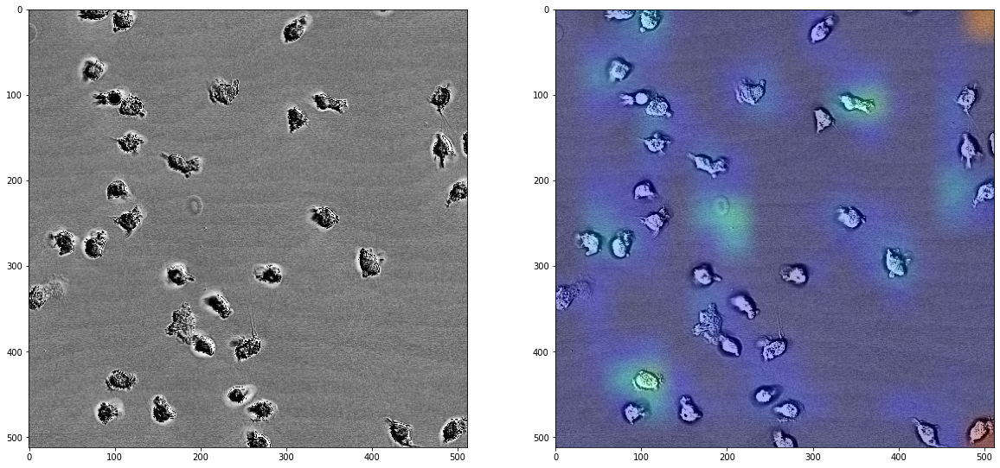

Original_label =  C. glabrata
1/1 [==============================] - 0s 54ms/step
Predicted: C. glabrata


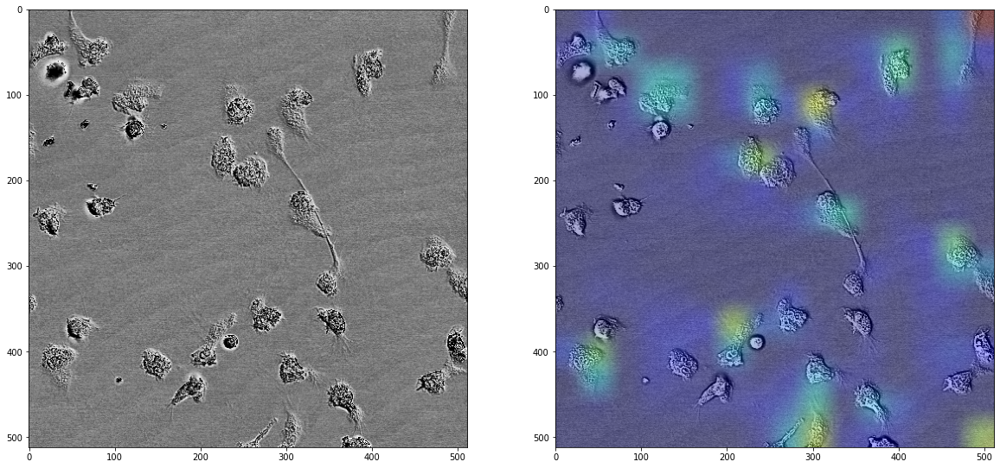

Original_label =  C. albicans
1/1 [==============================] - 0s 65ms/step
Predicted: Mock


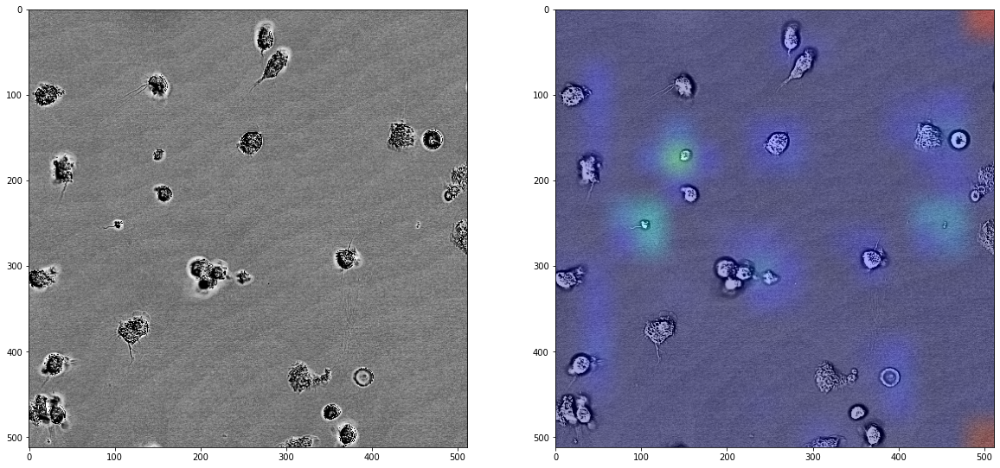

Original_label =  C. glabrata
1/1 [==============================] - 0s 52ms/step
Predicted: C. glabrata


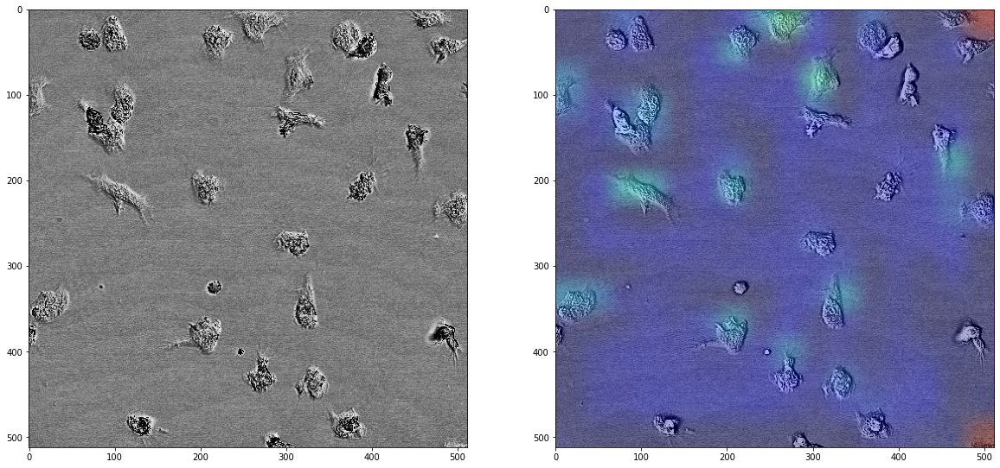

Original_label =  C. glabrata
1/1 [==============================] - 0s 285ms/step
Predicted: C. glabrata


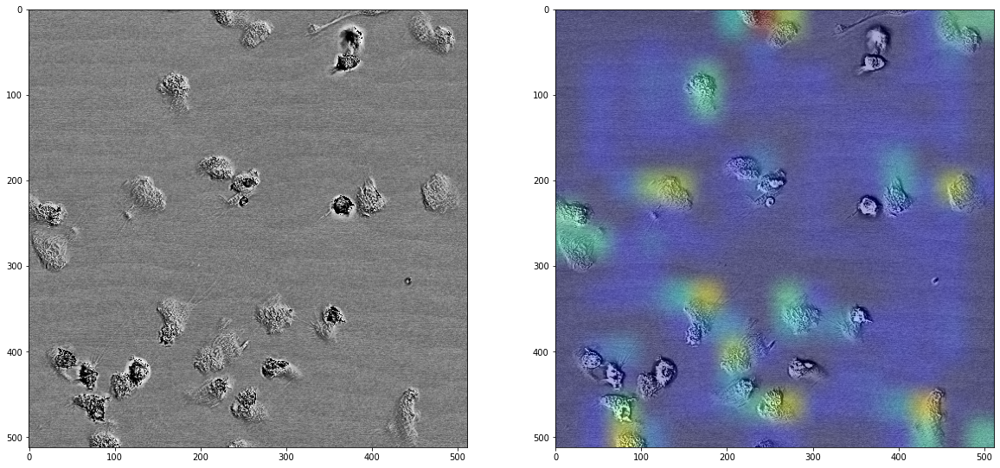

Original_label =  C. albicans
1/1 [==============================] - 0s 375ms/step
Predicted: C. albicans


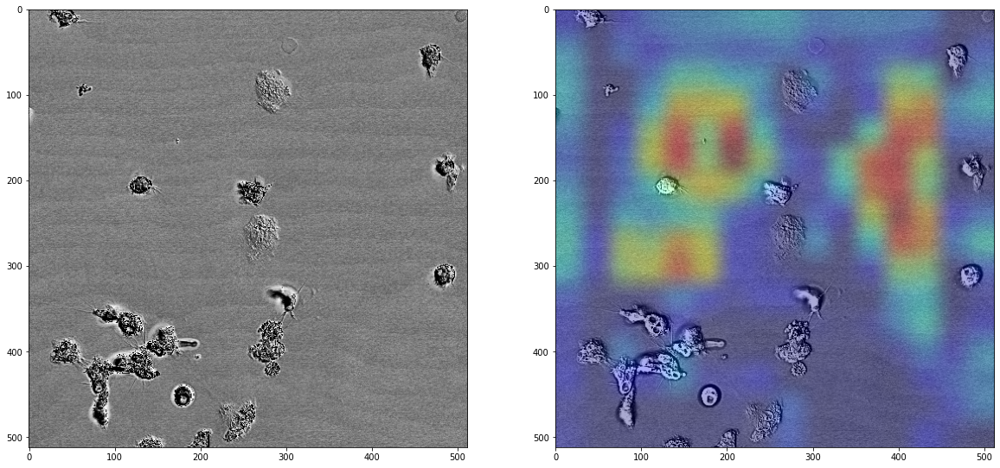

Original_label =  C. albicans
1/1 [==============================] - 0s 345ms/step
Predicted: C. albicans


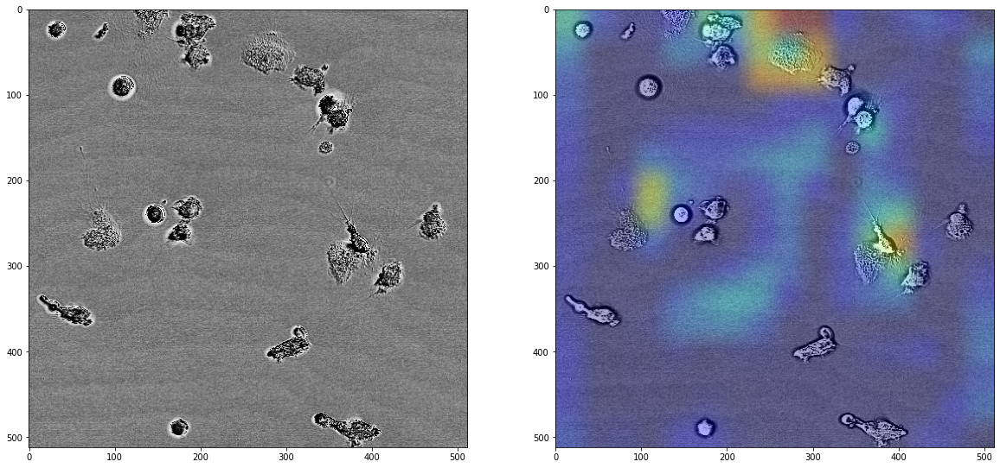

Original_label =  C. glabrata
1/1 [==============================] - 0s 341ms/step
Predicted: C. glabrata


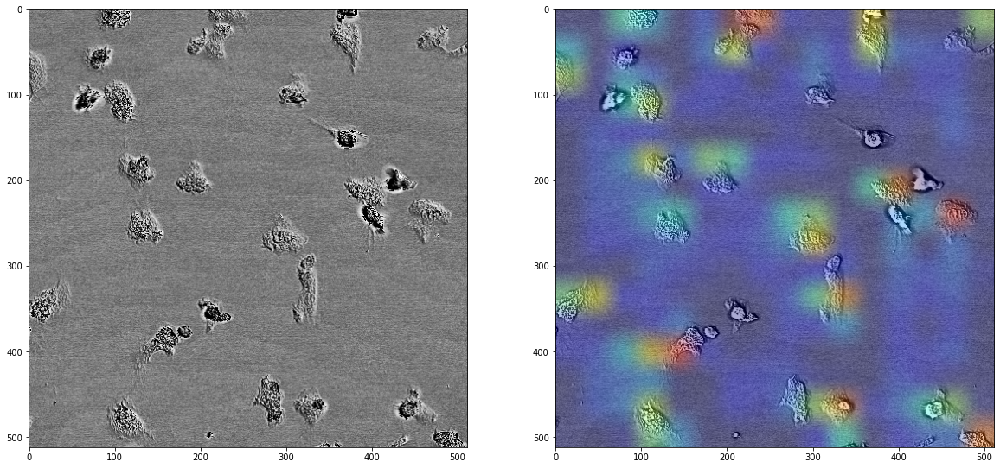

Original_label =  Mock
1/1 [==============================] - 0s 288ms/step
Predicted: Mock


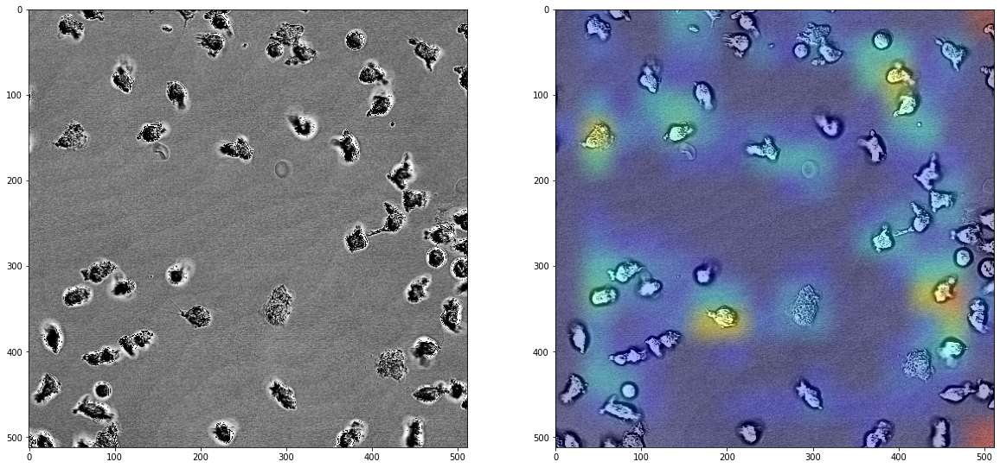

Original_label =  C. albicans
1/1 [==============================] - 0s 276ms/step
Predicted: C. albicans


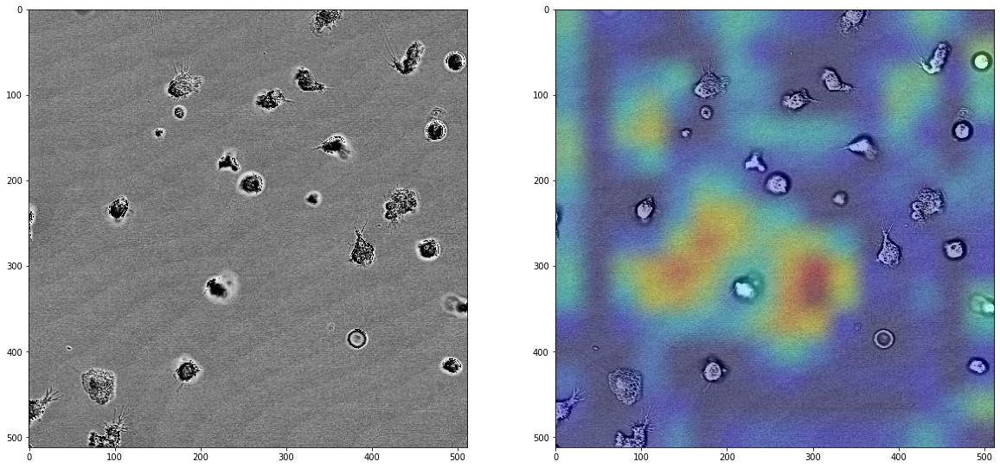

Original_label =  Mock
1/1 [==============================] - 0s 466ms/step
Predicted: Mock


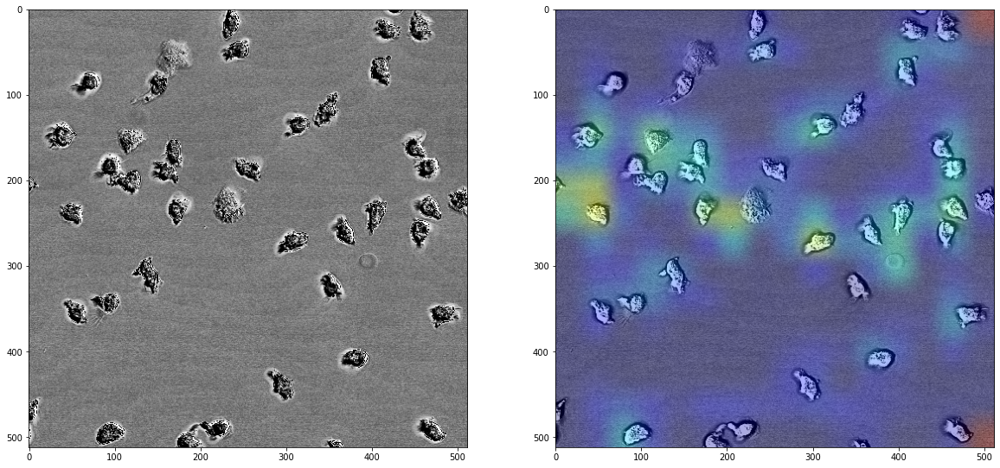

Original_label =  C. albicans
1/1 [==============================] - 0s 363ms/step
Predicted: Mock


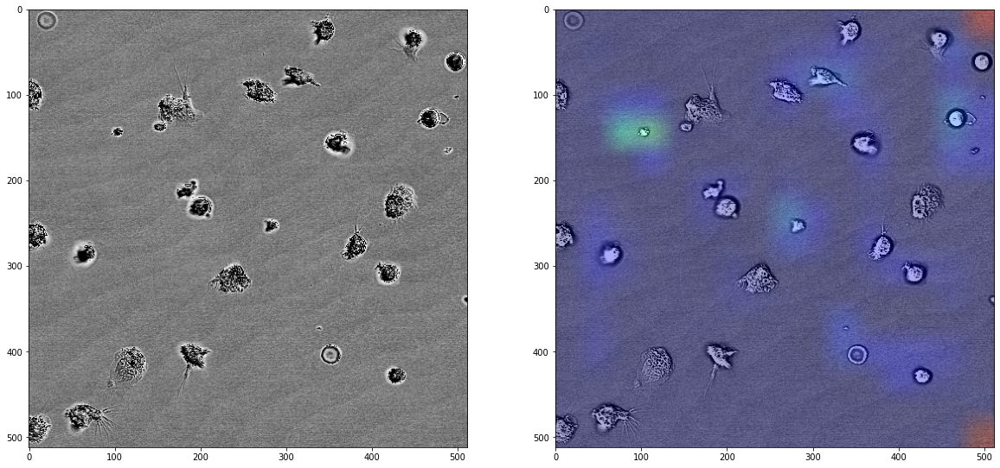

Original_label =  C. glabrata
1/1 [==============================] - 0s 379ms/step
Predicted: C. glabrata


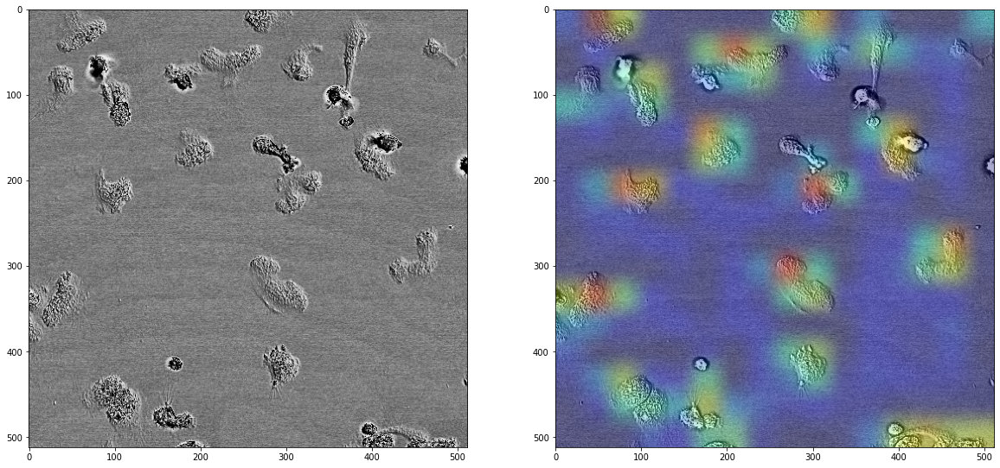

Original_label =  Mock
1/1 [==============================] - 0s 359ms/step
Predicted: Mock


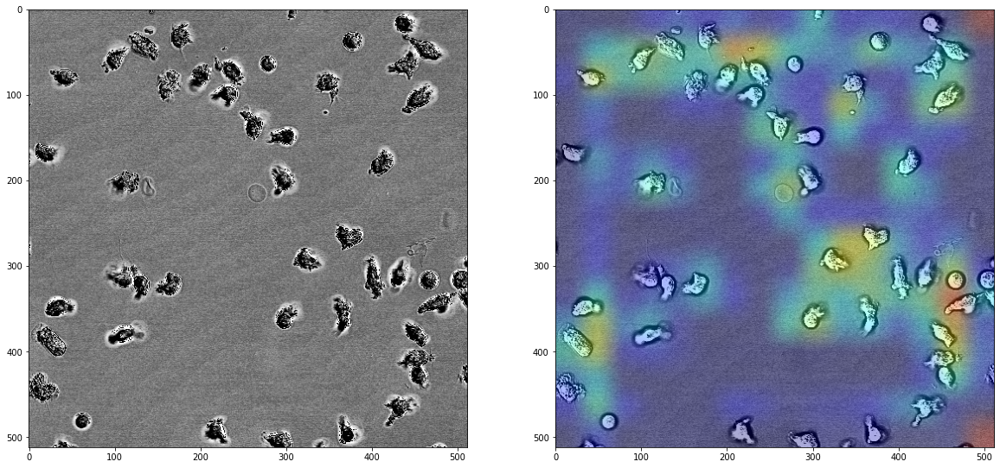

Original_label =  C. albicans
1/1 [==============================] - 0s 377ms/step
Predicted: C. albicans


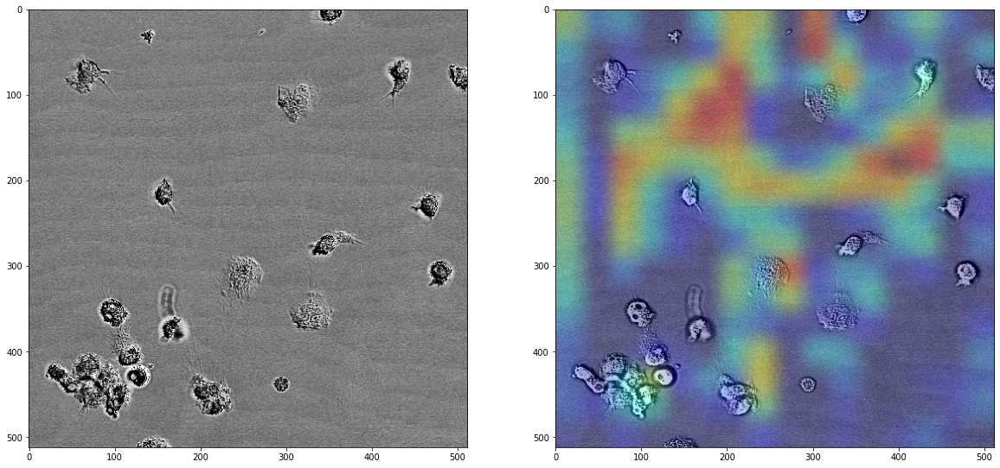

Original_label =  C. albicans
1/1 [==============================] - 0s 373ms/step
Predicted: C. albicans


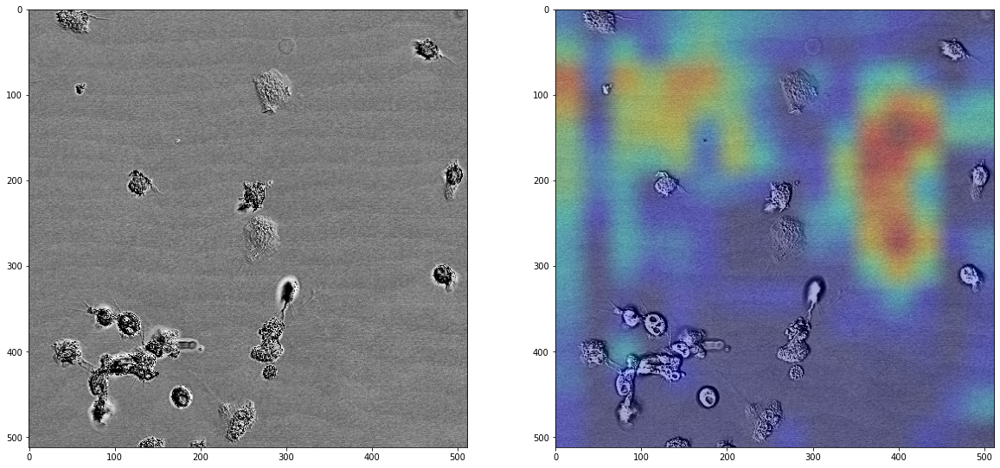

Original_label =  C. albicans
1/1 [==============================] - 0s 165ms/step
Predicted: C. albicans


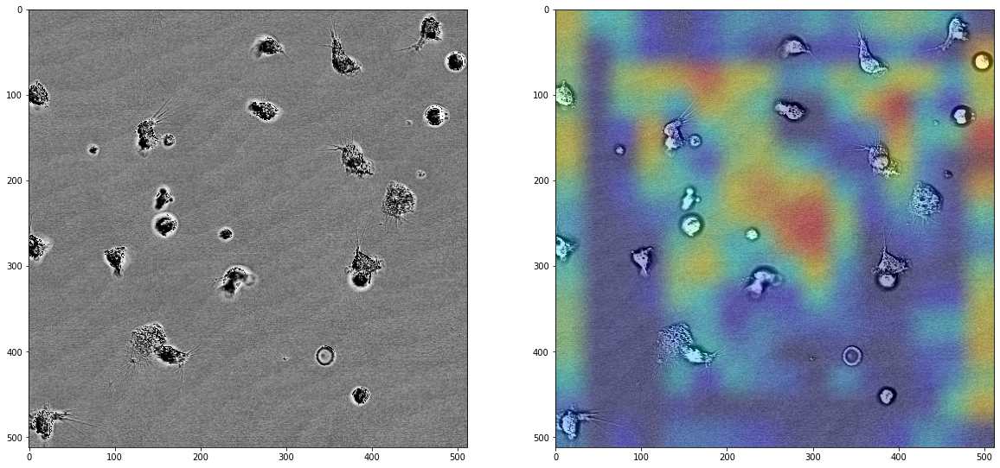

Original_label =  C. albicans
1/1 [==============================] - 0s 349ms/step
Predicted: C. albicans


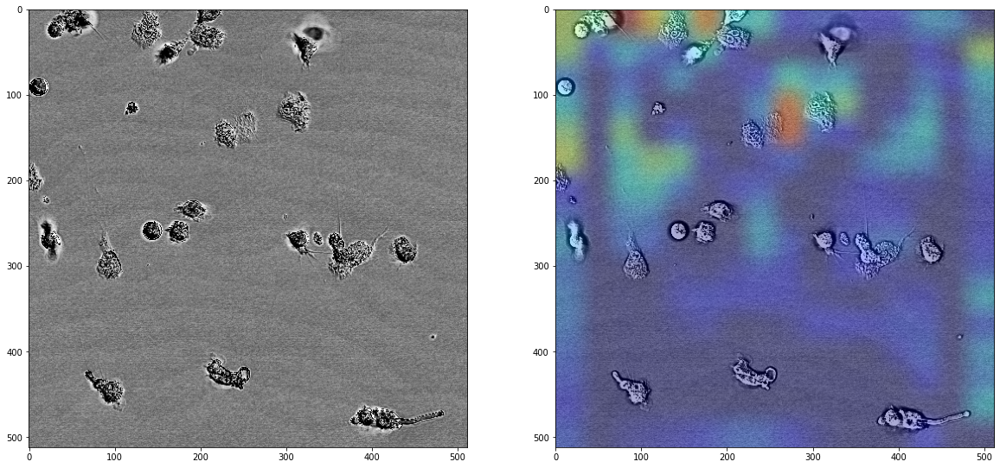

Original_label =  Mock
1/1 [==============================] - 0s 390ms/step
Predicted: Mock


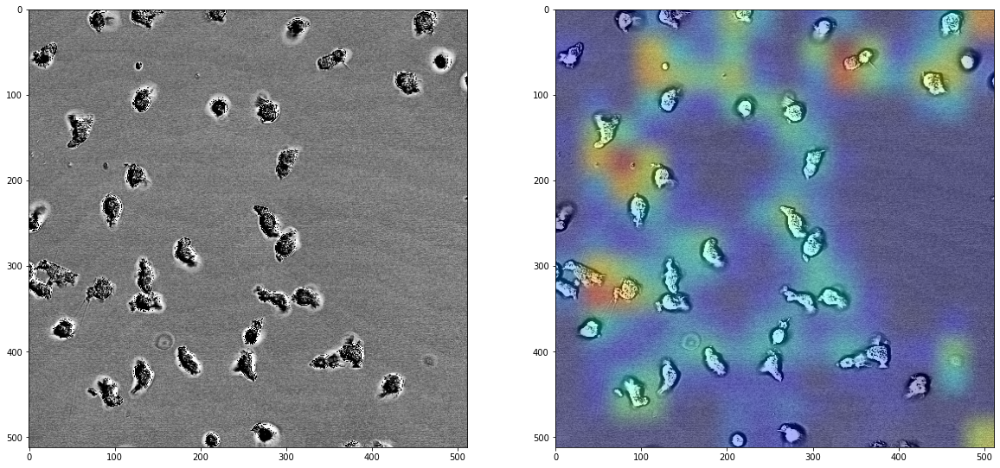

Original_label =  C. albicans
1/1 [==============================] - 0s 344ms/step
Predicted: C. albicans


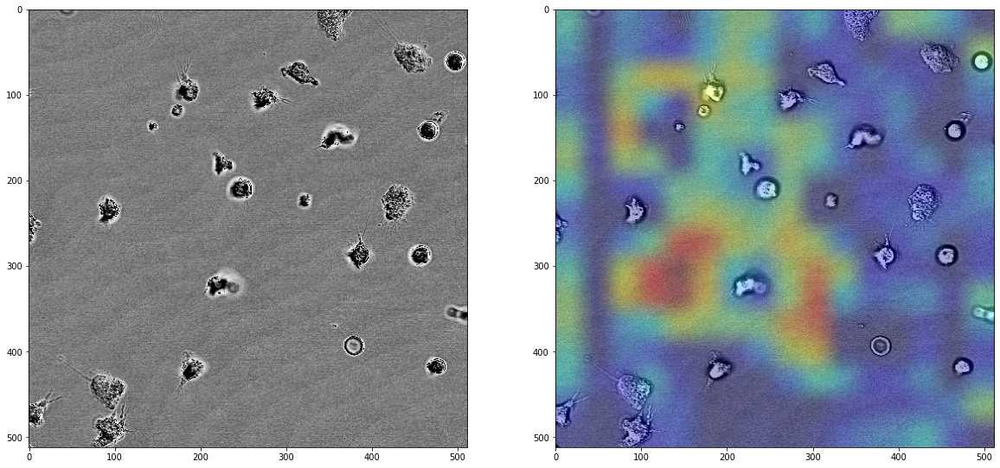

In [13]:
target_names = ["C. albicans","C. glabrata","Mock"]

for i, items in grad_test.iterrows():
    img_array = preprocess_input(get_img_array(items[6], image_size=image_size))
    
    img = load_original_image(items[6], image_size=image_size)
    print ('Original_label = ',target_names[items[5]])

    # Print what the top predicted class is
    preds = model_gradcam.predict(img_array)

    print('Predicted:',target_names[int(preds.argmax(axis=1))])
    
    # Generate class activation heatmap
    heatmap = make_gradcam_heatmap(img_array, model_gradcam, last_conv_layer_name)
    
    num = i
    save_and_display_gradcam(img, heatmap, num)